In [1]:
!pip install spotipy

     |████████████████████████████████| 62 kB 962 kB/s 
     |████████████████████████████████| 138 kB 49.0 MB/s 
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.26.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


#### Notebook Imports

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spotipy
import os

%matplotlib inline

#### Reading the data

In [4]:
spotify_data = pd.read_csv('sample_data/data.csv.zip')
genres = pd.read_csv('sample_data/data_by_genres.csv')
years = pd.read_csv('sample_data/data_by_year.csv')

In [5]:
# Spotify Data
spotify_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
# Genre Data
genres.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [7]:
# Data By Year
years.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


#### Data Analysis

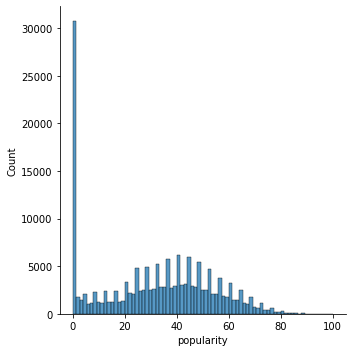

In [8]:
sns.displot(spotify_data['popularity'])

In [9]:
spotify_data['popularity']

0          4
1          5
2          5
3          3
4          2
          ..
170648    72
170649    68
170650    76
170651    70
170652    74
Name: popularity, Length: 170653, dtype: int64

#### Music Over Time

In [10]:
def get_decade(year):
    period_start = int(year / 10) * 10
    decade = '{}s'.format(period_start)
    
    return decade

spotify_data['decade'] = spotify_data['year'].apply(get_decade)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


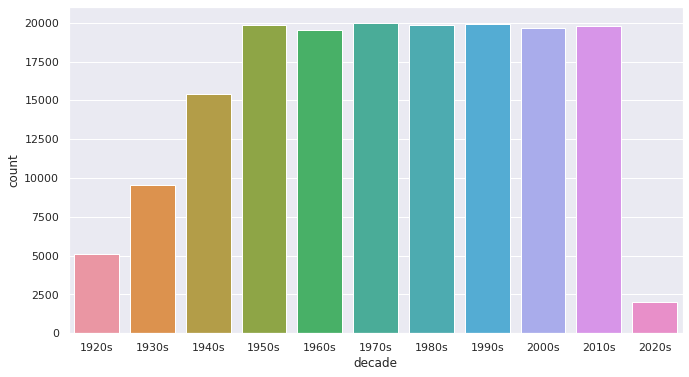

In [11]:
sns.set(rc = {'figure.figsize':(11, 6)})
sns.countplot(spotify_data['decade'])

#### Features Comparison

In [12]:
years.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


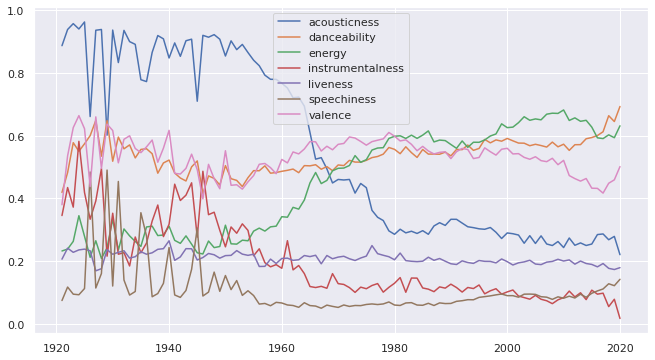

In [13]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'speechiness', 'valence']

for i in sound_features:
  plt.plot(years['year'], years[i], label = i)

plt.legend()
plt.show()

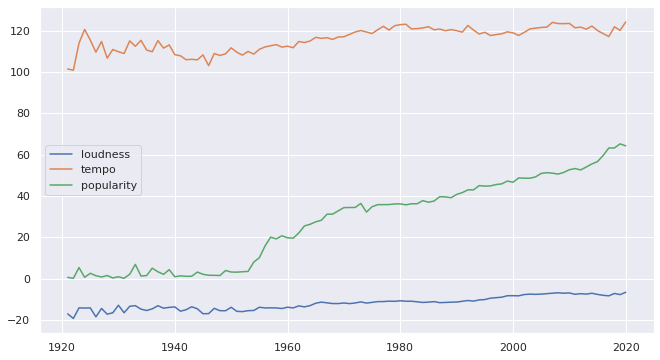

In [14]:
sound_features2 = ['loudness', 'tempo', 'popularity']

for i in sound_features2:
  plt.plot(years['year'], years[i], label = i)

plt.legend()
plt.show()



*   Danceability
*   Energy
*   Popularity
*   Valence
*   Liveness



#### Characteristics of Different Genres

In [15]:
top10_genres = genres.nlargest(10, 'popularity')

In [16]:
top10_genres

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
237,1,basshall,0.213167,0.81800,169799.166667,0.630167,0.000020,0.081067,-6.627833,0.134833,115.092500,0.588667,80.666667,2
2533,1,south african house,0.043833,0.84700,311854.333333,0.562333,0.130339,0.075133,-7.719000,0.050733,123.676333,0.834333,80.000000,1
2755,1,trap venezolano,0.044600,0.87700,231848.000000,0.777000,0.000035,0.086300,-4.246000,0.117000,102.020000,0.706000,80.000000,1
2778,0,turkish edm,0.008290,0.69800,186700.000000,0.719000,0.000004,0.326000,-4.923000,0.045500,120.062000,0.364000,80.000000,0
46,0,alberta hip hop,0.330000,0.88500,144000.000000,0.685000,0.000000,0.148000,-6.429000,0.062700,99.954000,0.937000,78.500000,11
536,0,chinese electropop,0.002570,0.66000,217088.000000,0.787000,0.000000,0.323000,-4.592000,0.032000,142.018000,0.199000,78.500000,1
37,0,afroswing,0.318450,0.71175,179995.375000,0.580187,0.000258,0.189950,-7.016687,0.195563,83.250125,0.676625,77.312500,11
31,0,afro soul,0.006270,0.76600,202627.000000,0.873000,0.000000,0.076400,-6.381000,0.143000,126.988000,0.743000,77.000000,11
575,1,circuit,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7
1239,1,guaracha,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7


#### Genre Clusters

In [17]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])

X = genres.select_dtypes(np.number)
cluster_pipeline.fit(X)
genres['cluster'] = cluster_pipeline.predict(X)

In [18]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genres['genres']
projection['cluster'] = genres['cluster']

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.005s...
[t-SNE] Computed neighbors for 2973 samples in 0.324s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.162s
[t-SNE] Iteration 50: error = 81.9579315, gradient norm = 0.0168576 (50 iterations in 2.139s)
[t-SNE] Iteration 100: error = 76.4552460, gradient norm = 0.0059848 (50 iterations in 1.531s)
[t-SNE] Iteration 150: error = 76.1382446, gradient norm = 0.0008329 (50 iterations in 1.167s)
[t-SNE] Iteration 200: error = 76.1168365, gradient norm = 0.0002357 (50 iterations in 1.197s)
[t-SNE] Iteration 250: error = 76.1101074, gradient norm = 0.0002661 (50 iterations in 1.188s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.110107
[t-SNE] Iteration 300: erro

In [19]:
import plotly.express as px

fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

#### Song Clusters

In [20]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=2, n_jobs=4))],verbose=True)
X = spotify_data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
spotify_data['cluster_label'] = song_cluster_labels

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............ (step 2 of 2) Processing kmeans, total=  49.5s


In [21]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)

projection['title'] = spotify_data['name']
projection['cluster'] = spotify_data['cluster_label']

In [22]:
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

#### Content-Based Filter Recommender System

In [29]:
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
import spotipy
import sys

In [32]:
sp = spotipy.Spotify(auth_manager = SpotifyClientCredentials(client_id = "0d13cfc9b5564ffe92fea35cb587c7c2",
                                                           client_secret = "f2945f7b32544ec4a4f46b2b7f30ccbe"))

In [33]:
def find_song(name, year):
    
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,
                                                       year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]

    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    
    for key, value in audio_features.items():
        song_data[key] = value
    
    return pd.DataFrame(song_data)

In [34]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

In [35]:
def get_song_data(song, spotify_data):
  
  try:
      song_data = spotify_data[(spotify_data['name'] == song['name']) 
                              & (spotify_data['year'] == song['year'])].iloc[0]
      return song_data
  
  except IndexError:
      return find_song(song['name'], song['year'])

In [36]:
def get_mean_vector(song_list, spotify_data):
    
  song_vectors = []
  
  for song in song_list:
      song_data = get_song_data(song, spotify_data)
      if song_data is None:
          print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
          continue
      song_vector = song_data[number_cols].values
      song_vectors.append(song_vector)  
  
  song_matrix = np.array(list(song_vectors))
  return np.mean(song_matrix, axis=0)

In [37]:
def flatten_dict_list(dict_list):
    
  flattened_dict = defaultdict()
  for key in dict_list[0].keys():
      flattened_dict[key] = []
  
  for dictionary in dict_list:
      for key, value in dictionary.items():
          flattened_dict[key].append(value)
          
  return flattened_dict

In [39]:
def recommend_songs( song_list, spotify_data, n_songs=10):
    
  metadata_cols = ['name', 'year', 'artists']
  song_dict = flatten_dict_list(song_list)
  
  song_center = get_mean_vector(song_list, spotify_data)
  scaler = song_cluster_pipeline.steps[0][1]
  scaled_data = scaler.transform(spotify_data[number_cols])
  scaled_song_center = scaler.transform(song_center.reshape(1, -1))
  distances = cdist(scaled_song_center, scaled_data, 'cosine')
  index = list(np.argsort(distances)[:, :n_songs][0])
  
  rec_songs = spotify_data.iloc[index]
  rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
  return rec_songs[metadata_cols].to_dict(orient = 'records')

In [40]:
recommend_songs([{'name': 'Call out my name', 'year': 2018},
                {'name': 'Save your tears', 'year': 2020},
                {'name': 'Blinding lights', 'year': 2020},
                {'name': 'I was never there', 'year': 2018},
                {'name': 'Hurt You', 'year': 2018}],  spotify_data)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



[{'artists': "['Machine Gun Kelly']",
  'name': 'bloody valentine',
  'year': 2020},
 {'artists': "['girl in red']", 'name': 'bad idea!', 'year': 2019},
 {'artists': "['The Chainsmokers', '5 Seconds of Summer']",
  'name': 'Who Do You Love',
  'year': 2019},
 {'artists': "['Ariana Grande']", 'name': 'God is a woman', 'year': 2018},
 {'artists': "['Marshmello', 'Khalid']", 'name': 'Silence', 'year': 2017},
 {'artists': "['JVLA']",
  'name': 'Such a Whore (Stellular Remix)',
  'year': 2020},
 {'artists': "['Sam Smith', 'Demi Lovato']",
  'name': 'I’m Ready (with Demi Lovato)',
  'year': 2020},
 {'artists': "['Juice WRLD']", 'name': 'Legends', 'year': 2018},
 {'artists': "['Juice WRLD', 'Marshmello']",
  'name': 'Come & Go (with Marshmello)',
  'year': 2020},
 {'artists': "['Ariana Grande']", 'name': 'obvious', 'year': 2020}]